## Import

In [1]:
import autoLabeling
import imgaugGen

import imgaug as ia
from imgaug import augmenters as iaa

## 1. Dataset auto annotation
- `IMAGES_DIRECTORY_PATH`: The dataset path of your original unlabelled dataset
- `OUTPUT_DIR_NAME`: The name of automatically labelled dataset
- `Class_Ontology`: an Ontology defines how your Base Model is prompted, what your Dataset will describe, and what your Target Model will predict. A simple Ontology is the CaptionOntology which prompts a Base Model with text captions and maps them to class names.
- `DATA_STYLE`: The format of generated annotated dataset.
- `SPLIT_EN`: Split into train and validation. (In this step, you can split the dataset or auto labeling 2 times if you have train & validation dataset)

In [2]:
IMAGES_DIRECTORY_PATH = r"./Hard-Hat-Sample-2/test"
OUTPUT_DIR_NAME = "Hard-Hat-test_0813_1"
DATA_STYLE = 'yolo' # 'coco', 'yolo'
SPLIT_EN = 0 # 1 = ENABLE
SPLIT_RATIO = 0.8

CLASS_ONTOLOGY = {'heads':'heads', 'helmets':'helmets'}
#CLASS_ONTOLOGY = {'chocolate candy': 'candy'}
#CLASS_ONTOLOGY = {'yellow flower':'yellow flower', 'white flower':'white flower', 'red flower':'rose',}

box_threshold = 0.37
text_threshold = 0.25
extension = ".jpg"

CLASS = list(CLASS_ONTOLOGY.values())
print("Label: {}".format(CLASS))

Label: ['heads', 'helmets']


In [3]:
GDINO_label = autoLabeling.GroundingDINO_label(IMAGES_DIRECTORY_PATH, OUTPUT_DIR_NAME, CLASS_ONTOLOGY)
sv_dataset = GDINO_label.auto_labelgen_dataset(box_threshold, text_threshold, extension)
autoLabeling.create_dataset(OUTPUT_DIR_NAME, CLASS_ONTOLOGY, sv_dataset, DATA_STYLE, SPLIT_EN, SPLIT_RATIO)

trying to load grounding dino directly


torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\TensorShape.cpp:3610.)


final text_encoder_type: bert-base-uncased


A parameter name that contains `beta` will be renamed internally to `bias`. Please use a different name to suppress this warning.
A parameter name that contains `gamma` will be renamed internally to `weight`. Please use a different name to suppress this warning.
A parameter name that contains `beta` will be renamed internally to `bias`. Please use a different name to suppress this warning.
A parameter name that contains `gamma` will be renamed internally to `weight`. Please use a different name to suppress this warning.
A parameter name that contains `beta` will be renamed internally to `bias`. Please use a different name to suppress this warning.
A parameter name that contains `gamma` will be renamed internally to `weight`. Please use a different name to suppress this warning.
A parameter name that contains `beta` will be renamed internally to `bias`. Please use a different name to suppress this warning.
A parameter name that contains `gamma` will be renamed internally to `weight`. Pl

Labeling images:   0%|          | 0/10 [00:00<?, ?it/s]

The `device` argument is deprecated and will be removed in v5 of Transformers.
1Torch was not compiled with flash attention. (Triggered internally at C:\actions-runner\_work\pytorch\pytorch\builder\windows\pytorch\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:555.)
torch.utils.checkpoint: the use_reentrant parameter should be passed explicitly. In version 2.4 we will raise an exception if use_reentrant is not passed. use_reentrant=False is recommended, but if you need to preserve the current default behavior, you can pass use_reentrant=True. Refer to docs for more details on the differences between the two variants.
None of the inputs have requires_grad=True. Gradients will be None
`torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.


Finish! The auto lable dataset: autolabel_dataset\Hard-Hat-test_0813_1
Spliting on going!
Did not find autolabel_dataset\Hard-Hat-test_0813_1\annotations\000084_jpg.rf.LKmYVoXMorRChWko0Nya.txt, not moving anything to autolabel_dataset\Hard-Hat-test_0813_1\train\labels
Did not find autolabel_dataset\Hard-Hat-test_0813_1\annotations\000034_jpg.rf.0mntBqMcedEgW6QrwdDI.txt, not moving anything to autolabel_dataset\Hard-Hat-test_0813_1\train\labels
Did not find autolabel_dataset\Hard-Hat-test_0813_1\annotations\000073_jpg.rf.9EaB9p01tVNWApvRsHZn.txt, not moving anything to autolabel_dataset\Hard-Hat-test_0813_1\train\labels
Did not find autolabel_dataset\Hard-Hat-test_0813_1\annotations\000008_jpg.rf.s49ob873sx48vEbzq25T.txt, not moving anything to autolabel_dataset\Hard-Hat-test_0813_1\train\labels
Did not find autolabel_dataset\Hard-Hat-test_0813_1\annotations\000047_jpg.rf.f37BV43Dhpacj9itIjZo.txt, not moving anything to autolabel_dataset\Hard-Hat-test_0813_1\train\labels
Did not find au

Passing a `Dict[str, np.ndarray]` into `DetectionDataset` is deprecated and will be removed in `supervision-0.26.0`. Use a list of paths `List[str]` instead.


## 2. Check the auto labeling result (optional)
- You may want to use `labelimg` to check the auto labeling dataset and update some labels manually.
- In python env cmd, enter `labelimg`.

## 3. Data augmentation
- A technique to increase the diversity of your training set by applying image processing.
- The dataset should be yolo format, and it needs images, annotations txt files, and `data.yaml` which saves the classes.
- `DATASET_NAME`: Name of your custom dataset
- User can define there own augmentation in `seq` and `seq_effect`. Please refer here: [imgaug overview](https://imgaug.readthedocs.io/en/latest/source/overview_of_augmenters.html)
  

In [1]:
 # The original dataset
DATASET_NAME = 'chocolate'
AUG_IMG_EFFECT = 1 # 1:enable 0:diable
repeat_num = 2 # how many aug imgs per src img

# Image augmenting sections
ia.seed(1)
seq = iaa.Sequential([
    #iaa.Fliplr(0.5), #horizontal flips
    iaa.Affine(
        scale=(0.8, 1.2),
        translate_percent={"x": (-0.1, 0.1), "y": (-0.1, 0.1)},
        rotate=(-15, 15)
        ),
], random_order=True)

seq_effect = iaa.Sequential([
    iaa.Sometimes(
        0.5,
        iaa.GaussianBlur(sigma=(0, 10))),
    iaa.Sometimes(
        0.5,
        iaa.WithBrightnessChannels(iaa.Add((-70, 70)), to_colorspace=[iaa.CSPACE_Lab, iaa.CSPACE_HSV]),),
    iaa.Sometimes(
        0.5,
        iaa.GammaContrast((0.5, 2.0))),
], random_order=True)

In [2]:
My_aug_gen = imgaugGen.aug_gen(DATASET_NAME)
My_aug_gen.gen_aug_img_dataset(seq, seq_effect, AUG_IMG_EFFECT, repeat_num)

Gen aug images:   0%|          | 0/14 [00:00<?, ?it/s]

Finish!! The new dataset is here: autolabel_dataset\chocolate\aug


#### 3-1. Show one original image with annotation (optional)

In [10]:
from pathlib import Path
import imageio
import imgaug as ia
from imgaug.augmentables.bbs import BoundingBox, BoundingBoxesOnImage

import supervision as sv
import numpy as np

In [5]:
DATASET_NAME = 'chocolate'

IMG_DIR_PATH = f"autolabel_dataset\{DATASET_NAME}\images"
ANN_DIR_PATH = f"autolabel_dataset\{DATASET_NAME}\images"
DATA_YAML_PATH = f"autolabel_dataset\{DATASET_NAME}\data.yaml"
OUTPUT_GEN_PATH = f"autolabel_dataset\{DATASET_NAME}\\aug"

Path(OUTPUT_GEN_PATH).mkdir(parents=True, exist_ok=True)

ds = sv.DetectionDataset.from_yolo(
    images_directory_path=IMG_DIR_PATH,
    annotations_directory_path=ANN_DIR_PATH,
    data_yaml_path=DATA_YAML_PATH
)

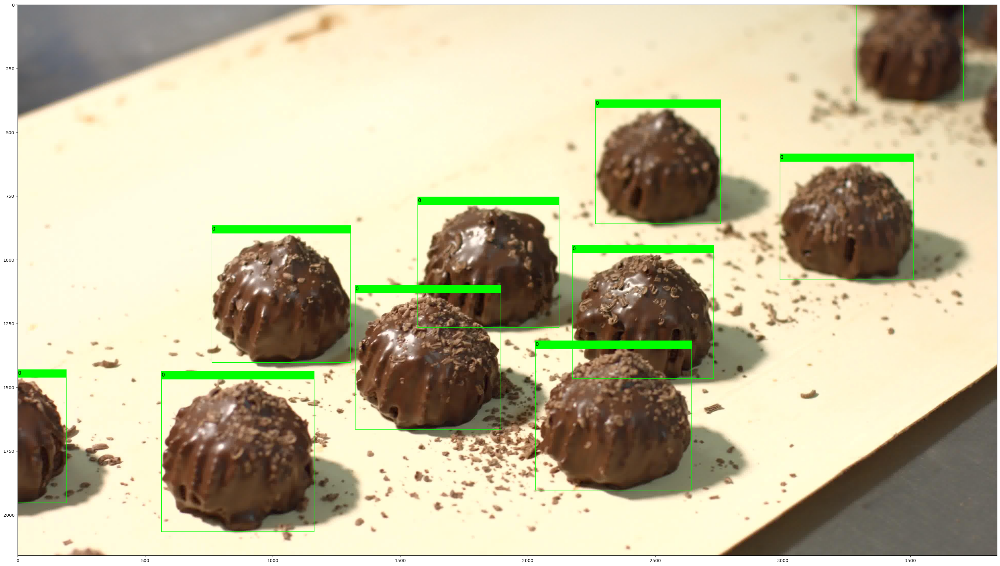

In [7]:
x = ds[0]
#print(x[0], x[2].xyxy, x[2].class_id)

# Create BoundingBoxes list
list_bbox = []
for idx_box, idx_cls in zip( x[2].xyxy, x[2].class_id):
    list_bbox.append(BoundingBox(x1=idx_box[0], x2=idx_box[2], y1=idx_box[1], y2=idx_box[3], label=idx_cls))

image = imageio.v2.imread(x[0])

bbs = BoundingBoxesOnImage(list_bbox, shape=image.shape)

ia.imshow(bbs.draw_on_image(image, size=2))

#### 3-2. Demo 5 images from data augmentation (optional)
- User can define there own augmentation. Please refer here: [imgaug overview](https://imgaug.readthedocs.io/en/latest/source/overview_of_augmenters.html)

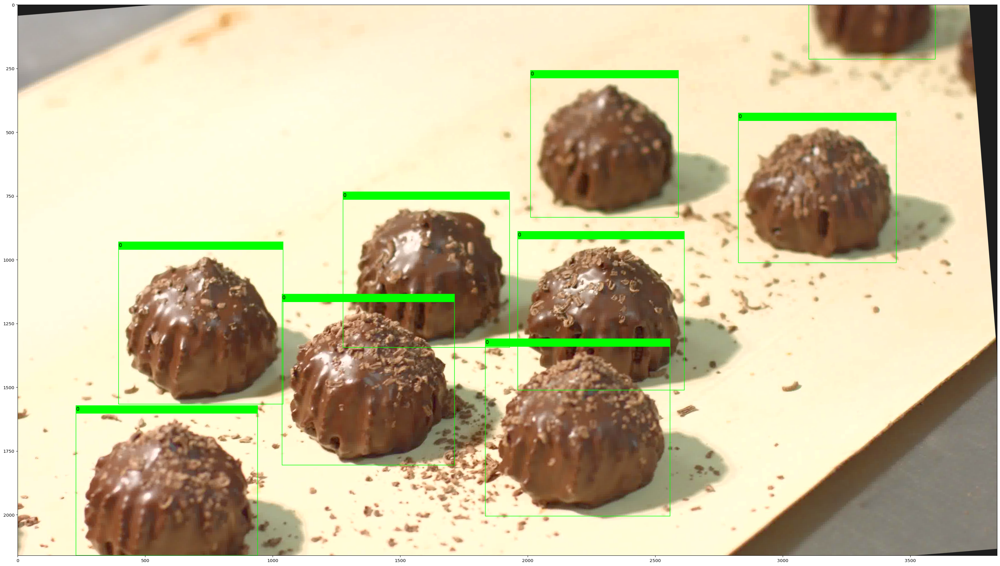

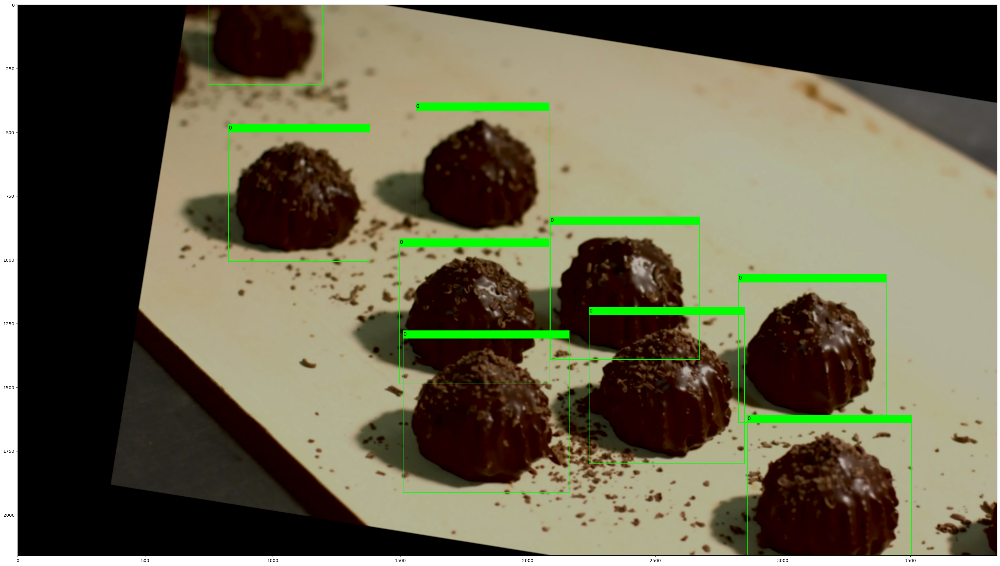

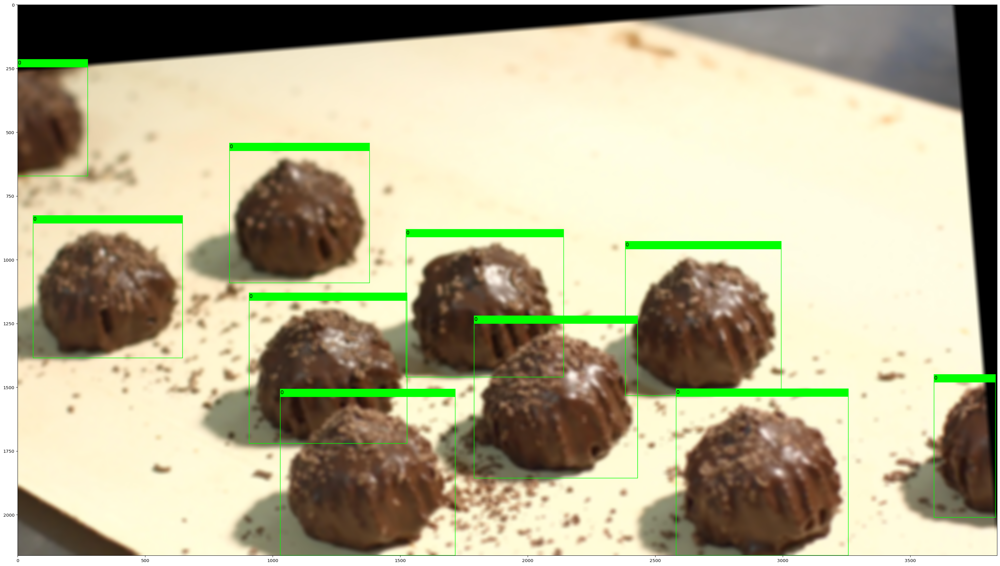

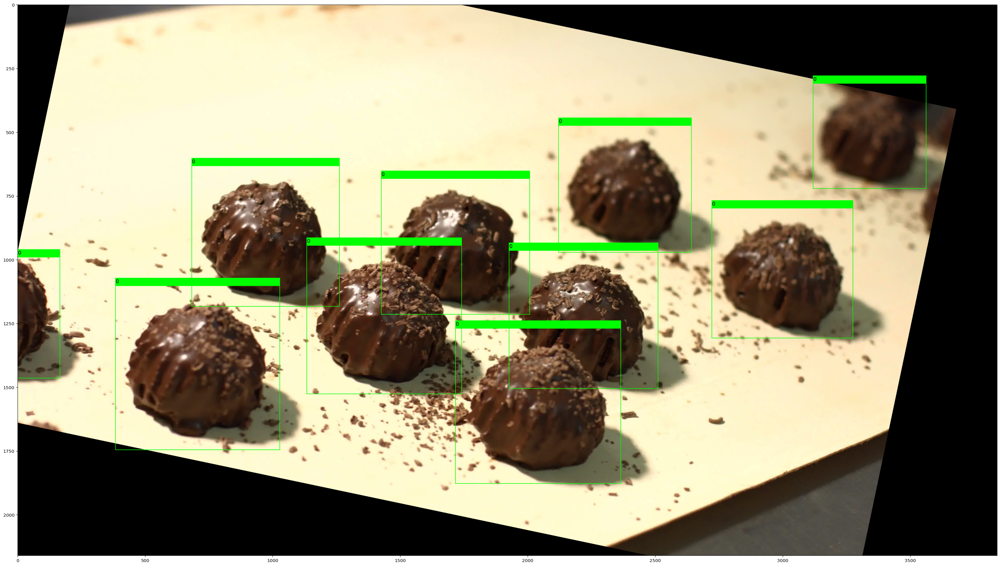

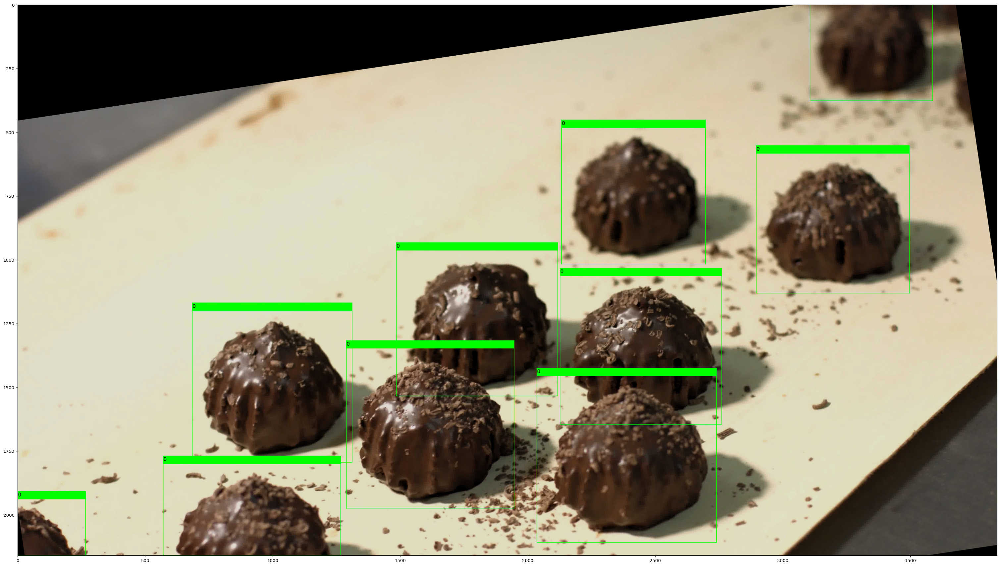

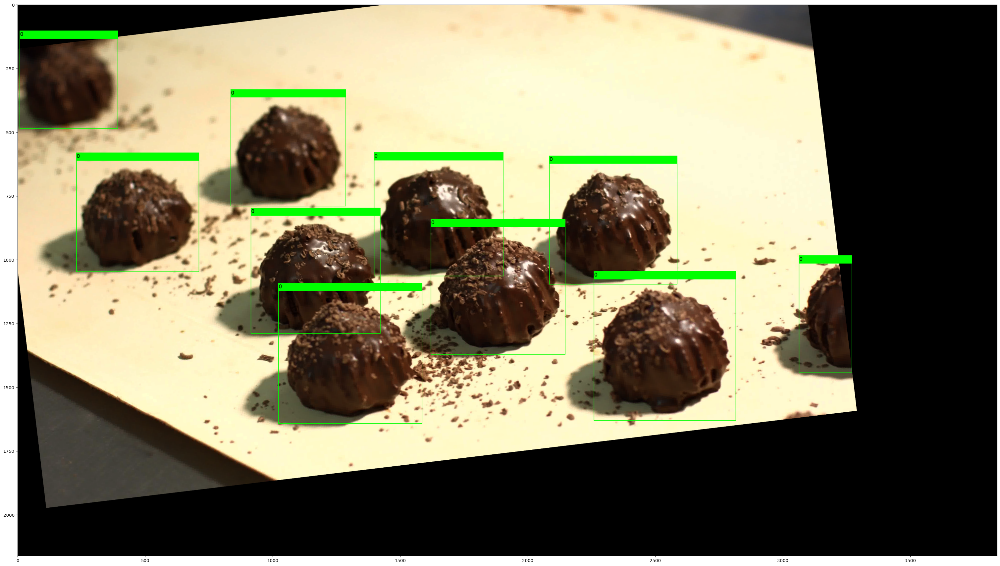

In [21]:
fig_list = []
for idx in range(5):
    image_aug, bbs_aug = seq(image=image, bounding_boxes=bbs)
    image_aug, bbs_aug = seq_effect(image=image_aug, bounding_boxes=bbs_aug)
    #print(bbs_aug)
    bbs_aug_adj = bbs_aug.remove_out_of_image_fraction(0.8).clip_out_of_image()
    #print(bbs_aug_adj)
    ia.imshow(bbs_aug_adj.draw_on_image(image_aug, size=2))
    #fig_list.append(bbs_aug_adj.draw_on_image(image_aug, size=2))
    
#side_by_side = np.hstack(fig_list)
#fig, ax = plt.subplots(figsize=(20, 20))
#ax.imshow(side_by_side)    

## 4. Convert to coco format and for yolox training

In [2]:
DATASET_NAME = "chocolate"
IMG_DIR_PATH = f"autolabel_dataset\{DATASET_NAME}\\aug"
ANN_DIR_PATH = f"autolabel_dataset\{DATASET_NAME}\\aug"
OUTPUT_DIR_PATH_COCO = f"autolabel_dataset\{DATASET_NAME}_coco"

autoLabeling.yolo2coco_dataset(IMG_DIR_PATH, ANN_DIR_PATH, OUTPUT_DIR_PATH_COCO)

Finish load as Yolo format!
Finish convert to Coco format!
Spliting on going!
[WinError 3] 系統找不到指定的路徑。: 'autolabel_dataset\\chocolate_coco\\train2017\\images'
